# Photogrammetry: Implementation of Data Pipeline 

# Data Set: 
* The dataset consists of 902 Pictures of the Heroic Monument of the Soviet Army in Vienna 
* Resolution: 6000x4000 pixel

# Imports

In [1]:
import imageio.v2 as imageio
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import scipy
import scipy.misc
import scipy.cluster
import skimage
import seaborn as sns
import matplotlib.image as img
import cv2
import torch
import urllib.request
from scipy.cluster.vq import kmeans
from sklearn.cluster import KMeans
from skimage import data, color
from skimage.filters import sobel
from skimage import exposure
%matplotlib inline 

# 1. Feature Extraction

## Data Loading

Text(0.5, 0, 'Width 6000')

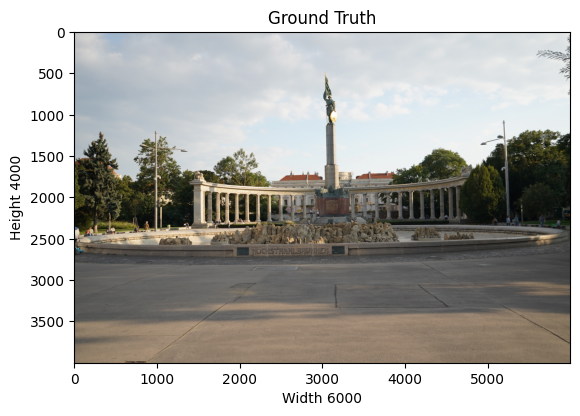

In [2]:
img = imageio.imread("..\data_pipeline\data\heldendenkmal.jpg")
plt.title('Ground Truth')
plt.imshow(img)
plt.ylabel('Height {}'.format(img.shape[0]))
plt.xlabel('Width {}'.format(img.shape[1]))

## 1.1 Basis Features

In [3]:
print('Image Type : ',type(img))
print('Image Shape : {}'.format(img.shape))
print('Image Height : {}'.format(img.shape[0]))
print('Image Width : {}'.format(img.shape[1]))

megapixels = (img.shape[0]*img.shape[1]/1000000)
print('Megapixels : {}'.format(megapixels))
print('Dimension of Image : {}'.format(img.ndim))

Image Type :  <class 'imageio.core.util.Array'>
Image Shape : (4000, 6000, 3)
Image Height : 4000
Image Width : 6000
Megapixels : 24.0
Dimension of Image : 3


## 1.2 Metadata

In [4]:
metadata =list(img.meta.keys())
print(metadata)

['exif', 'dpi', 'mp', 'EXIF_MAIN']


In [5]:
dpi = list(img.meta["dpi"])
mp = list(img.meta["mp"])
print(dpi)
print(mp)

[350.0, 350.0]
[73, 73, 42, 0, 8, 0, 0, 0, 3, 0, 0, 176, 7, 0, 4, 0, 0, 0, 48, 49, 48, 48, 1, 176, 4, 0, 1, 0, 0, 0, 2, 0, 0, 0, 2, 176, 7, 0, 32, 0, 0, 0, 50, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 160, 154, 211, 185, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 1, 64, 110, 221, 7, 0, 89, 64, 184, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


### 1.2.1 EXIF Data

In [6]:
exif_list = list({**img.meta["EXIF_MAIN"]})
print(exif_list)

['PrintImageMatching', 'ResolutionUnit', 'ExifOffset', 'ImageDescription', 'Make', 'Model', 'Software', 'Orientation', 'DateTime', 'YCbCrPositioning', 'XResolution', 'YResolution', 'ExifVersion', 'ComponentsConfiguration', 'CompressedBitsPerPixel', 'DateTimeOriginal', 'DateTimeDigitized', 'BrightnessValue', 'ExposureBiasValue', 'MaxApertureValue', 'MeteringMode', 'LightSource', 'Flash', 'FocalLength', 'UserComment', 'ColorSpace', 'ExifImageWidth', 'SceneCaptureType', 'OffsetTime', 'OffsetTimeOriginal', 'OffsetTimeDigitized', 'ExifImageHeight', 'FileSource', 'ExposureTime', 'ExifInteroperabilityOffset', 'FNumber', 'SceneType', 'ExposureProgram', 'CustomRendered', 'ISOSpeedRatings', 'ExposureMode', 'FlashPixVersion', 'SensitivityType', 'WhiteBalance', 'RecommendedExposureIndex', 'LensSpecification', 'LensModel', 'DigitalZoomRatio', 'FocalLengthIn35mmFilm', 'Contrast', 'Saturation', 'Sharpness', 'MakerNote']


In [7]:
{**img.meta['EXIF_MAIN']}

{'PrintImageMatching': b'PrintIM\x000300\x00\x00\x03\x00\x02\x00\x01\x00\x00\x00\x03\x00"\x00\x00\x00\x01\x01\x00\x00\x00\x00\t\x11\x00\x00\x10\'\x00\x00\x0b\x0f\x00\x00\x10\'\x00\x00\x97\x05\x00\x00\x10\'\x00\x00\xb0\x08\x00\x00\x10\'\x00\x00\x01\x1c\x00\x00\x10\'\x00\x00^\x02\x00\x00\x10\'\x00\x00\x8b\x00\x00\x00\x10\'\x00\x00\xcb\x03\x00\x00\x10\'\x00\x00\xe5\x1b\x00\x00\x10\'\x00\x00',
 'ResolutionUnit': 2,
 'ExifOffset': 364,
 'ImageDescription': '                               ',
 'Make': 'SONY',
 'Model': 'ILCE-7M3',
 'Software': 'ILCE-7M3 v3.01',
 'Orientation': 1,
 'DateTime': '2021:09:28 16:45:12',
 'YCbCrPositioning': 2,
 'XResolution': 350.0,
 'YResolution': 350.0,
 'ExifVersion': b'0231',
 'ComponentsConfiguration': b'\x01\x02\x03\x00',
 'CompressedBitsPerPixel': 4.0,
 'DateTimeOriginal': '2021:09:28 16:45:12',
 'DateTimeDigitized': '2021:09:28 16:45:12',
 'BrightnessValue': 8.32578125,
 'ExposureBiasValue': 0.0,
 'MaxApertureValue': 3.6171875,
 'MeteringMode': 5,
 'LightS

## 1.3 Color Properties

In [8]:
print('Image Size: {}'.format(img.size))
print('Maximum RGB Value:  {}'.format(img.max()))
print('Minimum RGB Value: {}'.format(img.min()))


Image Size: 72000000
Maximum RGB Value:  255
Minimum RGB Value: 0


In [9]:
print('R Channel Value: {}'.format(img[2500, 1000, 0]))
print('G Channel Value: {}'.format(img[2500, 1000, 1]))
print('B Channel Value: {}'.format(img[2500, 1000, 2]))

R Channel Value: 237
G Channel Value: 222
B Channel Value: 189


### 1.3.1 Visualize Color Channels

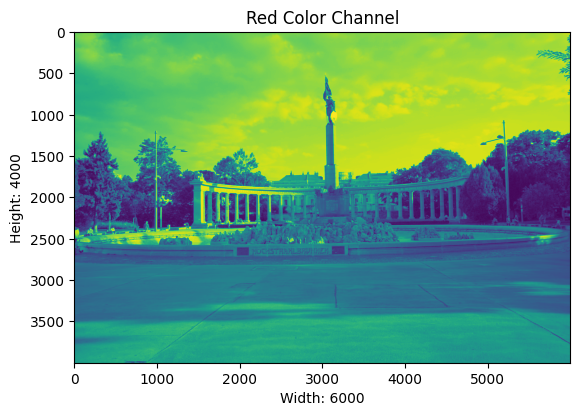

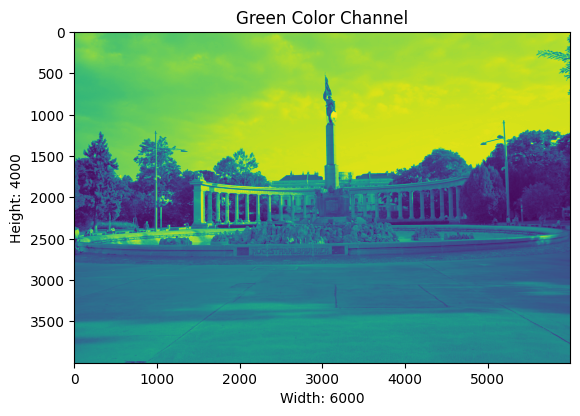

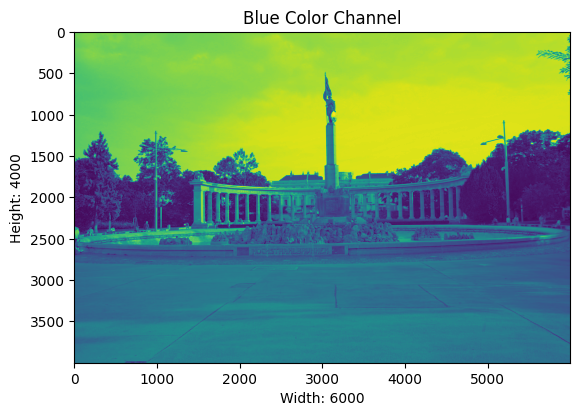

In [10]:
height = format(img.shape[0])
width = format(img.shape[1])

#Red Color Channel
r_channel = img[ : , : , 0]
plt.title('Red Color Channel')
plt.ylabel("Height: " +  height)
plt.xlabel("Width: " + width)
plt.imshow(r_channel)
plt.show()

#Green Color Channel
g_channel = img[ : , : , 1]
plt.title('Green Color Channel')
plt.ylabel("Height: " +  height)
plt.xlabel("Width: " + width)
plt.imshow(g_channel)
plt.show()

#Blue Color Channel
b_channel =  img[ : , : , 2]
plt.title('Blue Color Channel')
plt.ylabel("Height: " +  height)
plt.xlabel("Width: " + width)
plt.imshow(b_channel)
plt.show()


### 1.3.2 Visualize Color Intensitiy using Histogram

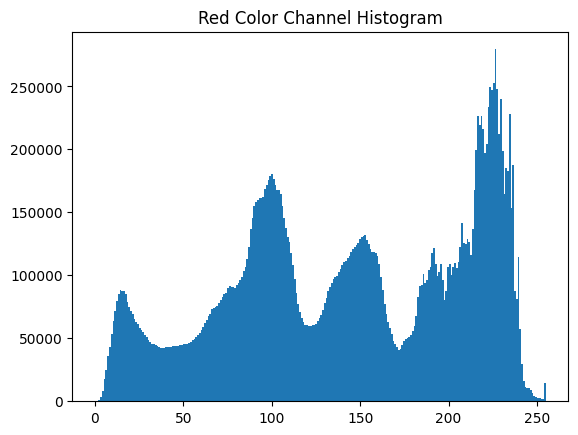

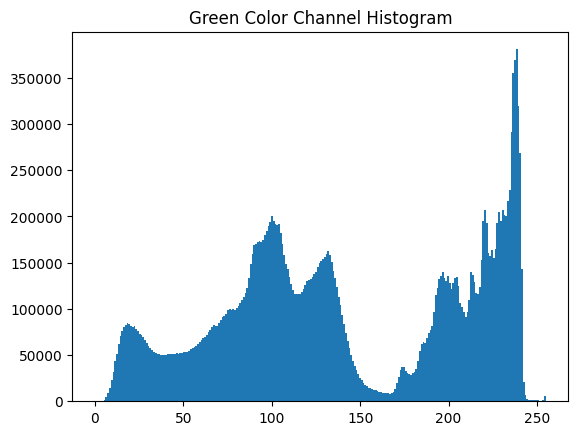

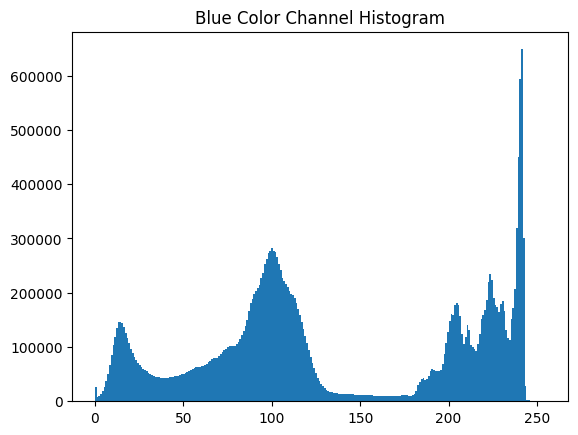

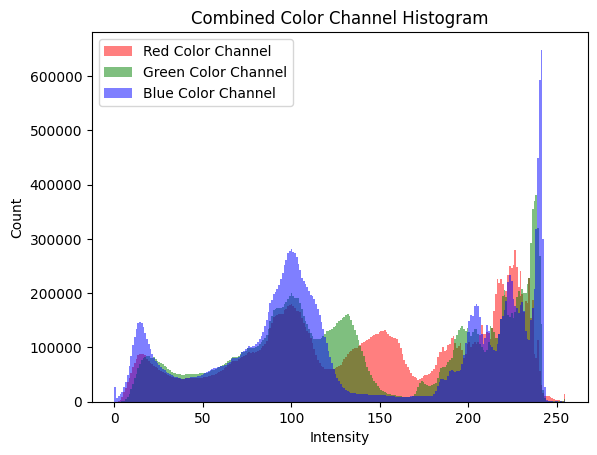

In [11]:
# Red Color Channel Histogram
plt.hist(r_channel.ravel(), bins=256)
plt.title('Red Color Channel Histogram')
plt.show()

# Green Color Histogram
plt.hist(g_channel.ravel(), bins=256)
plt.title('Green Color Channel Histogram')
plt.show()

# Blue Color Channel Histogram
plt.hist(b_channel.ravel(), bins=256)
plt.title('Blue Color Channel Histogram')
plt.show()

#Combined Color Channel Histogram
plt.hist(r_channel.ravel(), bins = 256, color = 'red', alpha = 0.5)
plt.hist(g_channel.ravel(), bins = 256, color = 'green', alpha = 0.5)
plt.hist(b_channel.ravel(), bins = 256, color = 'blue', alpha = 0.5)
plt.xlabel('Intensity')
plt.ylabel('Count')
plt.legend(['Red Color Channel', 'Green Color Channel', 'Blue Color Channel'])
plt.title('Combined Color Channel Histogram')
plt.show()


## 1.4 Dominant Colors

### First Approach

Reminder: It takes a lot of time to compute, therefore i commented it out for better notebook performance

In [12]:

#r = []
#g = []
#b = []
 
#for row in img:
    #for pixel in row:
        #r.append(pixel[0])
        #g.append(pixel[1])
        #b.append(pixel[2])

#df = pd.DataFrame({'red':r, 'green':g, 'blue':b})
 
#df.head()

#distortions = []
#num_clusters = range(1, 7)
 
# Distortion list from KMeans
#for i in num_clusters:
    #cluster_centers, distortion = kmeans(df[['red','green','blue']].values.astype(float), i)
    #distortions.append(distortion)

# Create a data frame with num_clusters, distortions
#elbow_plot = pd.DataFrame({'num_clusters': num_clusters, 'distortions': distortions})
 
# Ellbow plot
#sns.lineplot(x="num_clusters", y='distortions', data = elbow_plot)
#plt.xticks(num_clusters)
#plt.show()

#elbow_plot.head()

#cluster_centers, _ = kmeans(df[['red','green','blue']].values.astype(float), 2)
#cluster_centers

#plt.imshow(cluster_centers.reshape(1,2,3)/255.)
#plt.title("Dominant Colors using optimal k-Value")


### Second Approach

Also takes some time, but faster than first approach

In [13]:
#img=img.reshape((img.shape[1]*img.shape[0],3))

#kmeans=KMeans(n_clusters=5)
#clustering =kmeans.fit(img)

#labels=kmeans.labels_
#print(labels)
#labels=list(labels)

#centroid=kmeans.cluster_centers_
#print(centroid)

#percent=[]
#for i in range(len(centroid)):
  #j=labels.count(i)
  #j=j/(len(labels))
  #percent.append(j)
#print(percent)

#plt.pie(percent,colors=np.array(centroid/255),labels=np.arange(len(centroid)))
#plt.title("Dominant Colors with estimated clusters")
#plt.show()

## 1.5 Edge Detection 

In [14]:
def show_image(image, title='Image', cmap_type='gray'):
    plt.imshow(image, cmap=cmap_type)
    plt.title(title)
    plt.axis('off')
    plt.show()

In [15]:
gray_img = color.rgb2gray(img)

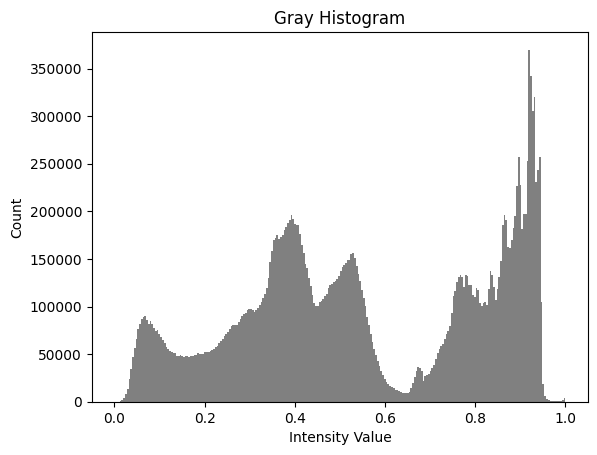

In [16]:
ax = plt.hist(gray_img.ravel(), bins = 256, color = "gray")
plt.title('Gray Histogram')
plt.xlabel('Intensity Value')
plt.ylabel('Count')
plt.show()

In [17]:
edge_sobel = sobel(gray_img)

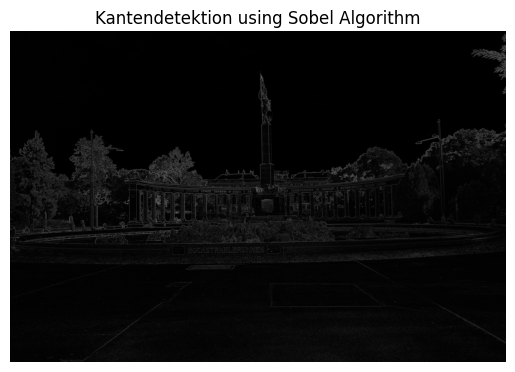

In [18]:
show_image(edge_sobel, "Kantendetektion using Sobel Algorithm")


In [19]:
image_eq =  exposure.equalize_hist(gray_img)

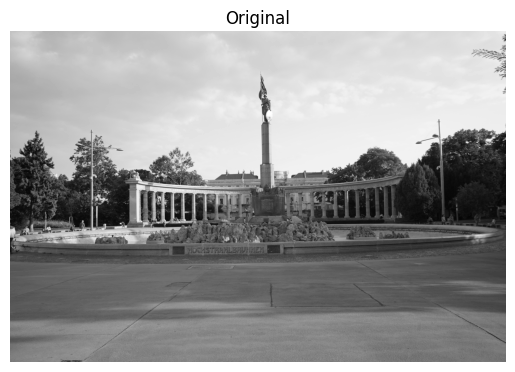

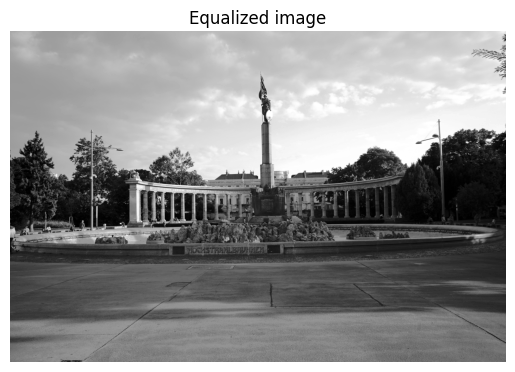

In [20]:
show_image(gray_img, 'Original')
show_image(image_eq, 'Equalized image')

In [21]:
edge_sobel_improved = sobel(image_eq)

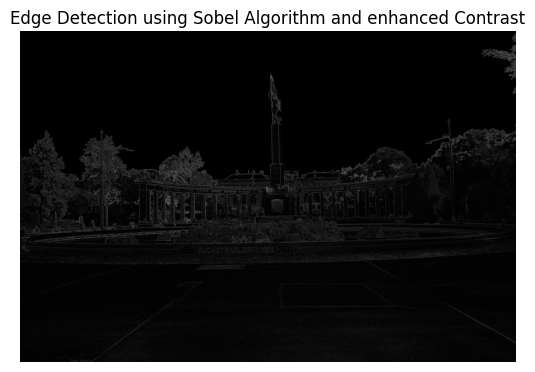

In [22]:
show_image(edge_sobel, "Edge Detection using Sobel Algorithm and enhanced Contrast")

## Canny Algoritmus

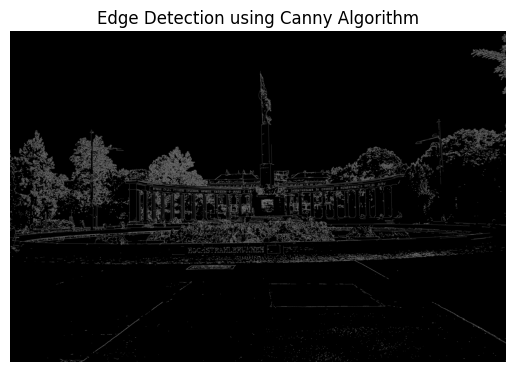

In [23]:
cv2_img = cv2.imread('..\data_pipeline\data\heldendenkmal.jpg')
cv2_img_gray = cv2.imread('..\data_pipeline\data\heldendenkmal.jpg',0)
cv2_img2 = cv2.imread('..\data_pipeline\data\heldendenkmal2.jpg')
cv2_img2_gray = cv2.imread('..\data_pipeline\data\heldendenkmal2.jpg',0)
canny_algorithm = cv2.Canny(cv2_img_gray,100,200)
show_image(canny_algorithm, "Edge Detection using Canny Algorithm")

# Image Matching

## Sift Algorithm

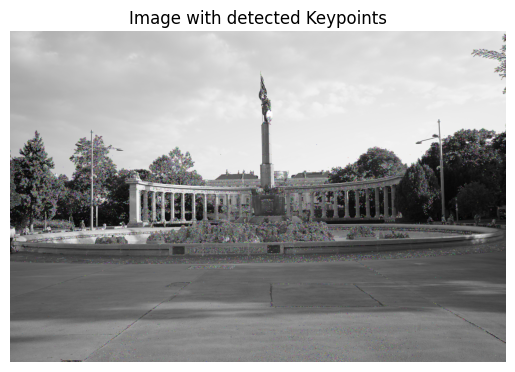

True

In [24]:
sift = cv2.SIFT_create()
keypoints = sift.detect(cv2_img,None)
detected_keypoints_img=cv2.drawKeypoints(cv2_img_gray,keypoints,cv2_img)
show_image(detected_keypoints_img, "Image with detected Keypoints")
cv2.imwrite('sift_keypoints.jpg',detected_keypoints_img)

## Search for matching Keypoints on two images

In [25]:
sift_for_matching = cv2.SIFT_create()
keypoints_1, descriptors_1 = sift.detectAndCompute(cv2_img_gray,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(cv2_img2_gray,None)

In [26]:
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

In [27]:
matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

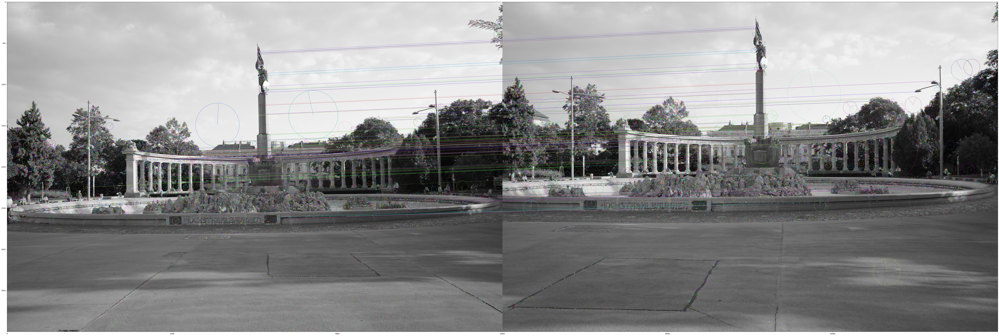

In [28]:
matching_img = cv2.drawMatches(cv2_img_gray, keypoints_1, cv2_img2_gray, keypoints_2, matches[:100], cv2_img2_gray, flags=4)

plt.figure(figsize=(100,70))
plt.imshow(matching_img)
plt.show()


# 1.6 Depth Estimation

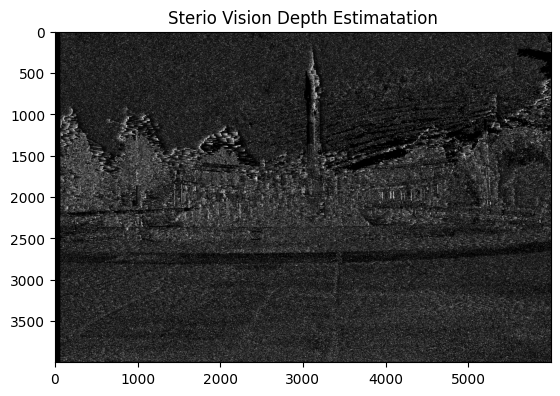

In [29]:
stereo = cv2.StereoBM_create(numDisparities=64, blockSize=5)
disparity = stereo.compute(cv2_img_gray,cv2_img2_gray)
plt.imshow(disparity,'gray')
plt.title("Sterio Vision Depth Estimatation")
plt.show()

In [30]:
processing_file = ("..\data_pipeline\data\heldendenkmal.jpg")

In [31]:
model_type = "DPT_Large"     # MiDaS v3 - Large     (highest accuracy, slowest inference speed)
#model_type = "DPT_Hybrid"   # MiDaS v3 - Hybrid    (medium accuracy, medium inference speed)
#model_type = "MiDaS_small"  # MiDaS v2.1 - Small   (lowest accuracy, highest inference speed)

In [32]:
midas = torch.hub.load("intel-isl/MiDaS", model_type)

Using cache found in C:\Users\jlarc/.cache\torch\hub\intel-isl_MiDaS_master


In [33]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
midas.to(device)
midas.eval()

DPTDepthModel(
  (pretrained): Module(
    (model): VisionTransformer(
      (patch_embed): PatchEmbed(
        (proj): Conv2d(3, 1024, kernel_size=(16, 16), stride=(16, 16))
        (norm): Identity()
      )
      (pos_drop): Dropout(p=0.0, inplace=False)
      (norm_pre): Identity()
      (blocks): Sequential(
        (0): Block(
          (norm1): LayerNorm((1024,), eps=1e-06, elementwise_affine=True)
          (attn): Attention(
            (qkv): Linear(in_features=1024, out_features=3072, bias=True)
            (attn_drop): Dropout(p=0.0, inplace=False)
            (proj): Linear(in_features=1024, out_features=1024, bias=True)
            (proj_drop): Dropout(p=0.0, inplace=False)
          )
          (ls1): Identity()
          (drop_path1): Identity()
          (norm2): LayerNorm((1024,), eps=1e-06, elementwise_affine=True)
          (mlp): Mlp(
            (fc1): Linear(in_features=1024, out_features=4096, bias=True)
            (act): GELU(approximate='none')
            (d

In [34]:
midas_transforms = torch.hub.load("intel-isl/MiDaS", "transforms")

if model_type == "DPT_Large" or model_type == "DPT_Hybrid":
    transform = midas_transforms.dpt_transform
else:
    transform = midas_transforms.small_transform

Using cache found in C:\Users\jlarc/.cache\torch\hub\intel-isl_MiDaS_master


In [35]:
img = cv2.imread(processing_file)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

input_batch = transform(img).to(device)

In [36]:
with torch.no_grad():
    prediction = midas(input_batch)

    prediction = torch.nn.functional.interpolate(
        prediction.unsqueeze(1),
        size=img.shape[:2],
        mode="bicubic",
        align_corners=False,
    ).squeeze()

depth_map = prediction.cpu().numpy()
depth_map = cv2.normalize(depth_map, None, 0, 1, norm_type = cv2.NORM_MINMAX, dtype = cv2.CV_64F)

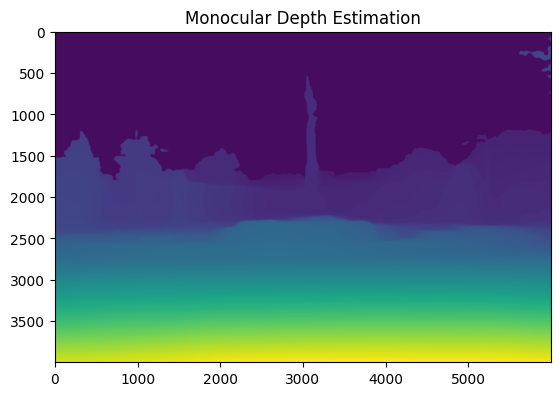

In [37]:
plt.title("Monocular Depth Estimation")
plt.imshow(depth_map)
# plt.show()

# 1.7 Meshing

## Open3D

In [38]:
import open3d as o3d
import os
import sys

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


## 1.7.1 Ball Pivoting Algorithm

In [39]:
bunny = o3d.data.BunnyMesh()
bunny_mesh = o3d.io.read_triangle_mesh(bunny.path)
bunny_mesh.compute_vertex_normals()
pcd_bunny = bunny_mesh.sample_points_poisson_disk(3000)
o3d.visualization.draw_geometries([pcd_bunny])

In [40]:
radii = [0.005, 0.01, 0.02, 0.04]

In [41]:
bpa_bunny= o3d.geometry.TriangleMesh.create_from_point_cloud_ball_pivoting(pcd_bunny, o3d.utility.DoubleVector(radii))

In [42]:
o3d.visualization.draw_geometries([pcd_bunny, bpa_bunny])

## 1.7.2 Poisson Reconstruction

In [43]:
eagle = o3d.data.EaglePointCloud()
pcd_eagle = o3d.io.read_point_cloud(eagle.path)
o3d.visualization.draw_geometries([pcd_eagle])

In [44]:
with o3d.utility.VerbosityContextManager(
    o3d.utility.VerbosityLevel.Debug) as cm:
    mesh,densities = o3d.geometry.TriangleMesh.create_from_point_cloud_poisson(
    pcd_eagle, depth = 9)
    
print(mesh)


[Open3D DEBUG] Input Points / Samples: 796825 / 368254
[Open3D DEBUG] #   Got kernel density: 0.107000 (s), 3849.39 (MB) / 3849.39 (MB) / 7106 (MB)
[Open3D DEBUG] #     Got normal field: 0.797 (s), 3957.23 (MB) / 3957.23 (MB) / 7106 (MB)
[Open3D DEBUG] Point weight / Estimated Area: 2.623547e-06 / 2.090508e+00
[Open3D DEBUG] #       Finalized tree: 0.476 (s), 4043.57 (MB) / 4043.57 (MB) / 7106 (MB)
[Open3D DEBUG] #  Set FEM constraints: 0.28 (s), 3993.82 (MB) / 4043.57 (MB) / 7106 (MB)
[Open3D DEBUG] #Set point constraints: 0.195 (s), 3980.66 (MB) / 4043.57 (MB) / 7106 (MB)
[Open3D DEBUG] Leaf Nodes / Active Nodes / Ghost Nodes: 2945433 / 3365000 / 1209
[Open3D DEBUG] Memory Usage: 3980.664 MB
[Open3D DEBUG] # Linear system solved: 0.937 (s), 4048.41 (MB) / 4048.41 (MB) / 7106 (MB)
[Open3D DEBUG] Got average: 0.0139999 (s), 3969.11 (MB) / 4048.41 (MB) / 7106 (MB)
[Open3D DEBUG] Iso-Value: 5.028479e-01 = 4.006817e+05 / 7.968250e+05
[Open3D DEBUG] #          Total Solve:       4.9 (s),  

In [45]:
o3d.visualization.draw_geometries([mesh])

## 1.7.3 Density 

In [46]:
densities = np.asarray(densities)
density_colors = plt.get_cmap("plasma")((densities - densities.min()) / (densities.max() - densities.min()))
density_colors = density_colors[:, :3]
density_mesh = o3d.geometry.TriangleMesh()
density_mesh.vertices = mesh.vertices
density_mesh.triangles = mesh.triangles
density_mesh.triangle_normals = mesh.triangle_normals
density_mesh.vertex_colors = o3d.utility.Vector3dVector(density_colors)

o3d.visualization.draw_geometries([density_mesh])

### 1.7.3.1 Remove low density to smoothen the model

In [47]:
vertices_to_remove = densities < np.quantile(densities, 0.01)
mesh.remove_vertices_by_mask(vertices_to_remove)
o3d.visualization.draw_geometries([mesh])